In [4]:
# Import your libraries:

%matplotlib inline

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from sklearn import metrics

In [5]:
data=pd.read_csv(r'./data.csv', skipinitialspace=True)
data

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,1,0.029890
6815,0,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,1,0.038284
6816,0,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,...,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,1,0.097649
6817,0,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,...,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,1,0.044009


In [ ]:
data.dtypes

Bankrupt?                                                    int64
ROA(C) before interest and depreciation before interest    float64
ROA(A) before interest and % after tax                     float64
ROA(B) before interest and depreciation after tax          float64
Operating Gross Margin                                     float64
                                                            ...   
Liability to Equity                                        float64
Degree of Financial Leverage (DFL)                         float64
Interest Coverage Ratio (Interest expense to EBIT)         float64
Net Income Flag                                              int64
Equity to Liability                                        float64
Length: 96, dtype: object

In [ ]:
data.isna().sum()

Bankrupt?                                                  0
ROA(C) before interest and depreciation before interest    0
ROA(A) before interest and % after tax                     0
ROA(B) before interest and depreciation after tax          0
Operating Gross Margin                                     0
                                                          ..
Liability to Equity                                        0
Degree of Financial Leverage (DFL)                         0
Interest Coverage Ratio (Interest expense to EBIT)         0
Net Income Flag                                            0
Equity to Liability                                        0
Length: 96, dtype: int64

In [ ]:
#pd.set_option('display.max_rows', None)

In [6]:
data.columns=data.columns.str.replace(' ','_')

In [ ]:
data

,Bankrupt?,ROA(C)_before_interest_and_depreciation_before_interest,ROA(A)_before_interest_and_%_after_tax,ROA(B)_before_interest_and_depreciation_after_tax,Operating_Gross_Margin,Realized_Sales_Gross_Margin,Operating_Profit_Rate,Pre-tax_net_Interest_Rate,After-tax_net_Interest_Rate,Non-industry_income_and_expenditure/revenue,Continuous_interest_rate_(after_tax),Operating_Expense_Rate,Research_and_development_expense_rate,Cash_flow_rate,Interest-bearing_debt_interest_rate,Tax_rate_(A),Net_Value_Per_Share_(B),Net_Value_Per_Share_(A),Net_Value_Per_Share_(C),Persistent_EPS_in_the_Last_Four_Seasons,Cash_Flow_Per_Share,Revenue_Per_Share_(Yuan_¥),Operating_Profit_Per_Share_(Yuan_¥),Per_Share_Net_profit_before_tax_(Yuan_¥),Realized_Sales_Gross_Profit_Growth_Rate,Operating_Profit_Growth_Rate,After-tax_Net_Profit_Growth_Rate,Regular_Net_Profit_Growth_Rate,Continuous_Net_Profit_Growth_Rate,Total_Asset_Growth_Rate,Net_Value_Growth_Rate,Total_Asset_Return_Growth_Rate_Ratio,Cash_Reinvestment_%,Current_Ratio,Quick_Ratio,Interest_Expense_Ratio,Total_debt/Total_net_worth,Debt_ratio_%,Net_worth/Assets,Long-term_fund_suitability_ratio_(A),Borrowing_dependency,Contingent_liabilities/Net_worth,Operating_profit/Paid-in_capital,Net_profit_before_tax/Paid-in_capital,Inventory_and_accounts_receivable/Net_value,Total_Asset_Turnover,Accounts_Receivable_Turnover,Average_Collection_Days,Inventory_Turnover_Rate_(times),Fixed_Assets_Turnover_Frequency,Net_Worth_Turnover_Rate_(times),Revenue_per_person,Operating_profit_per_person,Allocation_rate_per_person,Working_Capital_to_Total_Assets,Quick_Assets/Total_Assets,Current_Assets/Total_Assets,Cash/Total_Assets,Quick_Assets/Current_Liability,Cash/Current_Liability,Current_Liability_to_Assets,Operating_Funds_to_Liability,Inventory/Working_Capital,Inventory/Current_Liability,Current_Liabilities/Liability,Working_Capital/Equity,Current_Liabilities/Equity,Long-term_Liability_to_Current_Assets,Retained_Earnings_to_Total_Assets,Total_income/Total_expense,Total_expense/Assets,Current_Asset_Turnover_Rate,Quick_Asset_Turnover_Rate,Working_capitcal_Turnover_Rate,Cash_Turnover_Rate,Cash_Flow_to_Sales,Fixed_Assets_to_Assets,Current_Liability_to_Liability,Current_Liability_to_Equity,Equity_to_Long-term_Liability,Cash_Flow_to_Total_Assets,Cash_Flow_to_Liability,CFO_to_Assets,Cash_Flow_to_Equity,Current_Liability_to_Current_Assets,Liability-Assets_Flag,Net_Income_to_Total_Assets,Total_assets_to_GNP_price,No-credit_Interval,Gross_Profit_to_Sales,Net_Income_to_Stockholder's_Equity,Liability_to_Equity,Degree_of_Financial_Leverage_(DFL),Interest_Coverage_Ratio_(Interest_expense_to_EBIT),Net_Income_Flag,Equity_to_Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256969e-04,0.000000e+00,0.458143,7.250725e-04,0.000000,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820926e-04,1.165007e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,2.559237e-02,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897851e-04,0.000000e+00,0.461867,6.470647e-04,0.000000,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,0.004917,9

In [ ]:
data.describe()

,Bankrupt?,ROA(C)_before_interest_and_depreciation_before_interest,ROA(A)_before_interest_and_%_after_tax,ROA(B)_before_interest_and_depreciation_after_tax,Operating_Gross_Margin,Realized_Sales_Gross_Margin,Operating_Profit_Rate,Pre-tax_net_Interest_Rate,After-tax_net_Interest_Rate,Non-industry_income_and_expenditure/revenue,Continuous_interest_rate_(after_tax),Operating_Expense_Rate,Research_and_development_expense_rate,Cash_flow_rate,Interest-bearing_debt_interest_rate,Tax_rate_(A),Net_Value_Per_Share_(B),Net_Value_Per_Share_(A),Net_Value_Per_Share_(C),Persistent_EPS_in_the_Last_Four_Seasons,Cash_Flow_Per_Share,Revenue_Per_Share_(Yuan_¥),Operating_Profit_Per_Share_(Yuan_¥),Per_Share_Net_profit_before_tax_(Yuan_¥),Realized_Sales_Gross_Profit_Growth_Rate,Operating_Profit_Growth_Rate,After-tax_Net_Profit_Growth_Rate,Regular_Net_Profit_Growth_Rate,Continuous_Net_Profit_Growth_Rate,Total_Asset_Growth_Rate,Net_Value_Growth_Rate,Total_Asset_Return_Growth_Rate_Ratio,Cash_Reinvestment_%,Current_Ratio,Quick_Ratio,Interest_Expense_Ratio,Total_debt/Total_net_worth,Debt_ratio_%,Net_worth/Assets,Long-term_fund_suitability_ratio_(A),Borrowing_dependency,Contingent_liabilities/Net_worth,Operating_profit/Paid-in_capital,Net_profit_before_tax/Paid-in_capital,Inventory_and_accounts_receivable/Net_value,Total_Asset_Turnover,Accounts_Receivable_Turnover,Average_Collection_Days,Inventory_Turnover_Rate_(times),Fixed_Assets_Turnover_Frequency,Net_Worth_Turnover_Rate_(times),Revenue_per_person,Operating_profit_per_person,Allocation_rate_per_person,Working_Capital_to_Total_Assets,Quick_Assets/Total_Assets,Current_Assets/Total_Assets,Cash/Total_Assets,Quick_Assets/Current_Liability,Cash/Current_Liability,Current_Liability_to_Assets,Operating_Funds_to_Liability,Inventory/Working_Capital,Inventory/Current_Liability,Current_Liabilities/Liability,Working_Capital/Equity,Current_Liabilities/Equity,Long-term_Liability_to_Current_Assets,Retained_Earnings_to_Total_Assets,Total_income/Total_expense,Total_expense/Assets,Current_Asset_Turnover_Rate,Quick_Asset_Turnover_Rate,Working_capitcal_Turnover_Rate,Cash_Turnover_Rate,Cash_Flow_to_Sales,Fixed_Assets_to_Assets,Current_Liability_to_Liability,Current_Liability_to_Equity,Equity_to_Long-term_Liability,Cash_Flow_to_Total_Assets,Cash_Flow_to_Liability,CFO_to_Assets,Cash_Flow_to_Equity,Current_Liability_to_Current_Assets,Liability-Assets_Flag,Net_Income_to_Total_Assets,Total_assets_to_GNP_price,No-credit_Interval,Gross_Profit_to_Sales,Net_Income_to_Stockholder's_Equity,Liability_to_Equity,Degree_of_Financial_Leverage_(DFL),Interest_Coverage_Ratio_(Interest_expense_to_EBIT),Net_Income_Flag,Equity_to_Liability
count,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6.819000e+03,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6.819000e+03,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.000000,6819.0,6819.000000
mean,0.032263,0.505180,0.558625,0.553589,0.607948,0.607929,0.998755,0.797190,0.809084,0.303623,0.781381,1.995347e+09,1.950427e+09,0.467431,1.644801e+07,0.11

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
# Your comment here
corr = data.corr()
# Set up the figure size
plt.figure(figsize=(150, 100))
# Draw the heatmap with the annotations and the right color
sns.heatmap(corr, annot=True, cmap= 'coolwarm')

<AxesSubplot:>

In [7]:
delete_list_1=['ROA(C)_before_interest_and_depreciation_before_interest', 'ROA(A)_before_interest_and_%_after_tax', 'Realized_Sales_Gross_Margin', 'Pre-tax_net_Interest_Rate', 'Continuous_interest_rate_(after_tax)']

In [8]:
data.drop(delete_list_1, inplace=True, axis = 1)

In [ ]:
# Your comment here
corr = data.corr()
# Set up the figure size
plt.figure(figsize=(150, 100))
# Draw the heatmap with the annotations and the right color
sns.heatmap(corr, annot=True, cmap= 'coolwarm')

<AxesSubplot:>

In [9]:
delete_list_2=['ROA(B)_before_interest_and_depreciation_after_tax', 'Net_Value_Per_Share_(B)', 'Net_Value_Per_Share_(C)', 'Per_Share_Net_profit_before_tax_(Yuan_¥)', 'Current_Liabilities/Equity', 'Cash_Flow_to_Sales', 'Current_Liability_to_Equity'] 

In [10]:
data.drop(delete_list_2, inplace=True, axis = 1)

In [ ]:
# Your comment here
corr = data.corr()
# Set up the figure size
plt.figure(figsize=(150, 100))
# Draw the heatmap with the annotations and the right color
sns.heatmap(corr, annot=True, cmap= 'coolwarm')

<AxesSubplot:>

In [11]:
delete_list_3=['Persistent_EPS_in_the_Last_Four_Seasons', 'Regular_Net_Profit_Growth_Rate', 'Borrowing_dependency', 'Operating_profit/Paid-in_capital', 'Current_Liability_to_Liability'] 

In [12]:
data.drop(delete_list_3, inplace=True, axis = 1)

In [ ]:
# Your comment here
corr = data.corr()
# Set up the figure size
plt.figure(figsize=(150, 100))
# Draw the heatmap with the annotations and the right color
sns.heatmap(corr, annot=True, cmap= 'coolwarm')

<AxesSubplot:>

In [13]:
data.drop('Gross_Profit_to_Sales', inplace=True, axis = 1)

In [14]:
data.shape

(6819, 78)

In [ ]:
# # Create correlation matrix
# corr_matrix = data.corr().abs()

# # Select upper triangle of correlation matrix
# upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# # Find features with correlation greater than 0.90
# to_drop = [column for column in upper.columns if any(upper[column] > 0.90)]

# # Drop features 
# data.drop(to_drop, axis=1, inplace=True)

# data.shape
#(6819, 77)


In [ ]:
data.columns

Index(['Bankrupt?', 'Operating_Gross_Margin', 'Operating_Profit_Rate',
       'After-tax_net_Interest_Rate',
       'Non-industry_income_and_expenditure/revenue', 'Operating_Expense_Rate',
       'Research_and_development_expense_rate', 'Cash_flow_rate',
       'Interest-bearing_debt_interest_rate', 'Tax_rate_(A)',
       'Net_Value_Per_Share_(A)', 'Cash_Flow_Per_Share',
       'Revenue_Per_Share_(Yuan_¥)', 'Operating_Profit_Per_Share_(Yuan_¥)',
       'Realized_Sales_Gross_Profit_Growth_Rate',
       'Operating_Profit_Growth_Rate', 'After-tax_Net_Profit_Growth_Rate',
       'Continuous_Net_Profit_Growth_Rate', 'Total_Asset_Growth_Rate',
       'Net_Value_Growth_Rate', 'Total_Asset_Return_Growth_Rate_Ratio',
       'Cash_Reinvestment_%', 'Current_Ratio', 'Quick_Ratio',
       'Interest_Expense_Ratio', 'Total_debt/Total_net_worth', 'Debt_ratio_%',
       'Net_worth/Assets', 'Long-term_fund_suitability_ratio_(A)',
       'Contingent_liabilities/Net_worth',
       'Net_profit_before_tax/P

In [15]:
X = data.drop(['Bankrupt?'], axis = 1)
y = data['Bankrupt?']

In [16]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel

SFM = SelectFromModel(estimator=RandomForestClassifier())
s = SFM.fit(X, y)

n_features = s.transform(X).shape[1]
n_features

28

In [17]:
# Get the 27 feature names 
feature_idx = s.get_support()
feature_name = X.columns[feature_idx]
feature_name

Index(['After-tax_net_Interest_Rate',
       'Non-industry_income_and_expenditure/revenue',
       'Interest-bearing_debt_interest_rate', 'Net_Value_Per_Share_(A)',
       'Net_Value_Growth_Rate', 'Total_Asset_Return_Growth_Rate_Ratio',
       'Quick_Ratio', 'Interest_Expense_Ratio', 'Total_debt/Total_net_worth',
       'Debt_ratio_%', 'Net_worth/Assets',
       'Net_profit_before_tax/Paid-in_capital', 'Operating_profit_per_person',
       'Working_Capital_to_Total_Assets', 'Cash/Total_Assets',
       'Cash/Current_Liability', 'Inventory/Working_Capital',
       'Working_Capital/Equity', 'Retained_Earnings_to_Total_Assets',
       'Total_income/Total_expense', 'Net_Income_to_Total_Assets',
       'Total_assets_to_GNP_price', 'No-credit_Interval',
       'Net_Income_to_Stockholder's_Equity', 'Liability_to_Equity',
       'Degree_of_Financial_Leverage_(DFL)',
       'Interest_Coverage_Ratio_(Interest_expense_to_EBIT)',
       'Equity_to_Liability'],
      dtype='object')

In [18]:
X = X.loc[: , feature_idx]

In [ ]:
X

,After-tax_net_Interest_Rate,Non-industry_income_and_expenditure/revenue,Interest-bearing_debt_interest_rate,Net_Value_Per_Share_(A),Net_Value_Growth_Rate,Total_Asset_Return_Growth_Rate_Ratio,Interest_Expense_Ratio,Total_debt/Total_net_worth,Debt_ratio_%,Net_worth/Assets,Net_profit_before_tax/Paid-in_capital,Fixed_Assets_Turnover_Frequency,Operating_profit_per_person,Working_Capital_to_Total_Assets,Cash/Total_Assets,Cash/Current_Liability,Inventory/Working_Capital,Working_Capital/Equity,Retained_Earnings_to_Total_Assets,Total_income/Total_expense,Net_Income_to_Total_Assets,Total_assets_to_GNP_price,No-credit_Interval,Net_Income_to_Stockholder's_Equity,Liability_to_Equity,Degree_of_Financial_Leverage_(DFL),Interest_Coverage_Ratio_(Interest_expense_to_EBIT),Equity_to_Liability
0,0.808809,0.302646,7.250725e-04,0.147950,0.000327,0.263100,0.629951,0.021266,0.207576,0.792424,0.137757,1.165007e-04,0.392913,0.672775,0.004094,1.473360e-04,0.276920,0.721275,0.903225,0.002022,0.716845,0.009219,0.622879,0.827890,0.290202,0.026601,0.564050,0.016469
1,0.809301,0.303556,6.470647e-04,0.182251,0.000443,0.264516,0.635172,0.012502,0.171176,0.828824,0.168962,7.190000e+08,0.391590,0.751111,0.014948,1.383910e-03,0.289642,0.731975,0.931065,0.002226,0.795297,0.008323,0.623652,0.839969,0.283846,0.264577,0.570175,0.020794
2,0.808388,0.302035,7.900790e-04,0.177911,0.000396,0.264184,0.629631,0.021248,0.207516,0.792484,0.148036,2.650000e+09,0.381968,0.829502,0.000991,5.340000e+09,0.277456,0.742729,0.909903,0.002060,0.774670,0.040003,0.623841,0.836774,0.290189,0.026555,0.563706,0.016474
3,0.808966,0.303350,4.490449e-04,0.154187,0.000382,0.263371,0.630228,0.009572,0.151465,0.848535,0.147561,9.150000e+09,0.378497,0.725754,0.018851,1.010646e-03,0.276580,0.729825,0.906902,0.001831,0.739555,0.003252,0.622929,0.834697,0.281721,0.026697,0.564663,0.023982
4,0.809304,0.303475,6.860686e-04,0.167502,0.000439,0.265218,0.636055,0.005150,0.106509,0.893491,0.167461,2.935211e-04,0.394371,0.751822,0.014161,6.804636e-04,0.287913,0.732000,0.913850,0.002224,0.795016,0.003878,0.623521,0.839973,0.278514,0.024752,0.575617,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6814,0.809331,0.303510,1.790179e-04,0.175045,0.000450,0.264517,0.631415,0.006655,0.124618,0.875382,0.171111,1.429781e-04,0.392596,0.817769,0.099481,5.071548e-03,0.277543,0.736716,0.925611,0.002266,0.799927,0.000466,0.623620,0.840359,0.279606,0.027064,0.566193,0.029890
6815,0.809327,0.303520,2.370237e-04,0.181324,0.000445,0.264730,0.631489,0.004623,0.099253,0.900747,0.171805,6.051982e-04,0.393625,0.793387,0.080337,4.727181e-03,0.277368,0.734584,0.932629,0.002288,0.799748,0.001959,0.623931,0.840306,0.278132,0.027009,0.566018,0.038284
6816,0.809317,0.303512,0.000000e+00,0.269521,0.000435,0.263858,0.630612,0.001392,0.038939,0.961061,0.172287,1.024298e-03,0.393693,0.866047,0.412885,8.821248e-02,0.277022,0.737432,0.932000,0.002239,0.797778,0.002840,0.624156,0.840138,0.275789,0.026791,0.565158,0.097649
6817,0.809399,0.303498,2.110211e-04,0.213392,0.000529,0.264409,0.630731,0.003816,0.086979,0.913021,0.182498,2.330013e-04,0.396735,0.832340,0.112238,7.133218e-03,0.277353,0.736713,0.939613,0.002395,0.811808,0.002837,0.623957,0.841084,0.277547,0.026822,0.565302,0.044009


In [19]:
from sklearn.model_selection import train_test_split

from imblearn.over_sampling import SMOTE

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=5, stratify = y)
# the next x_train and y_train is the resampled x and y
x_train, y_train = SMOTE().fit_resample(x_train, y_train)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)




(9238, 28)
(9238,)
(2046, 28)
(2046,)


# ------------ Gaussian --------------

In [21]:
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
kernel = 1.0 * RBF(1.0)
gpc = GaussianProcessClassifier(kernel=kernel, random_state=0).fit(x_train, y_train)

KeyboardInterrupt: 

In [ ]:
y_pred_gpc=gpc.predict(x_test)

In [ ]:
confusion_matrix = metrics.confusion_matrix(y_test, y_pred_gpc)

In [ ]:
confusion_matrix

array([[1973,    7],
       [  58,    8]])

In [29]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [27]:
def generate_results(model, predictions, name):
    cl_rep = classification_report(y_test, predictions)
    print("\nThe classification report for " + name + " is:", cl_rep, sep = "\n")
    cm_model = metrics.confusion_matrix(y_test, predictions)
    plt.figure(figsize = (8, 6))
    sns.heatmap(cm_model, annot = True, cmap = 'Blues', annot_kws = {'size': 15}, square = True)
    plt.title('Confusion Matrix for ' + name, size = 15)
    plt.xticks(size = 15)
    plt.yticks(size = 15)
    plt.show()


The classification report for Gaussian Process Classifier is:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1980
           1       0.53      0.12      0.20        66

    accuracy                           0.97      2046
   macro avg       0.75      0.56      0.59      2046
weighted avg       0.96      0.97      0.96      2046



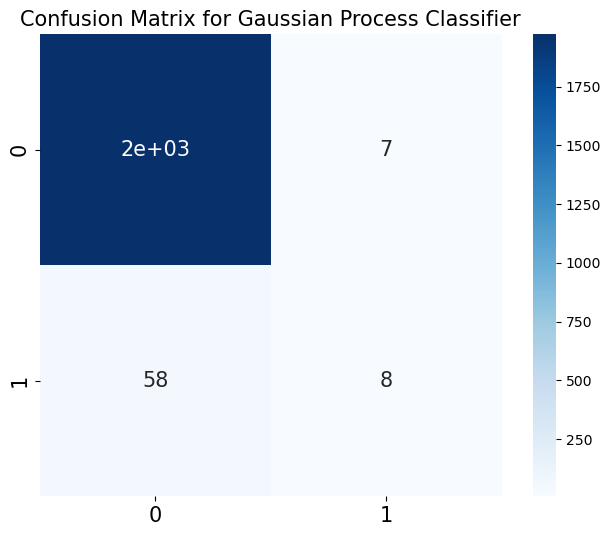

In [ ]:
generate_results(gpc, y_pred_gpc, 'Gaussian Process Classifier')

In [ ]:
from sklearn.metrics import roc_auc_score
print(metrics.roc_auc_score(y_test,y_pred_gpc))

0.5588383838383838


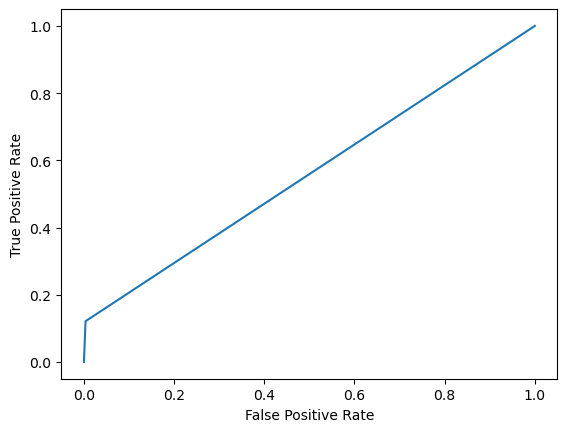

In [ ]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,y_pred_gpc)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr)
display.plot()
plt.show()

# --------------- TPOT -----------------

In [ ]:
# check tpot version
import tpot
print('tpot: %s' % tpot.__version__)

tpot: 0.11.7


/Users/jaimesastrecrespo/opt/anaconda3/lib/python3.9/site-packages/tpot/builtins/__init__.py:36: UserWarning: Warning: optional dependency `torch` is not available. - skipping import of NN models.
  warnings.warn("Warning: optional dependency `torch` is not available. - skipping import of NN models.")


In [ ]:
from tpot import TPOTClassifier

In [ ]:
pipeline_optimizer = TPOTClassifier(generations=5, population_size=20, cv=5,
                                    random_state=42, verbosity=2)

In [ ]:
pipeline_optimizer.fit(x_train, y_train)

Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.971716114019779

Generation 2 - Current best internal CV score: 0.971716114019779

Generation 3 - Current best internal CV score: 0.971716114019779

Generation 4 - Current best internal CV score: 0.971716114019779

Generation 5 - Current best internal CV score: 0.971716114019779

Best pipeline: RandomForestClassifier(input_matrix, bootstrap=True, criterion=gini, max_features=0.2, min_samples_leaf=8, min_samples_split=4, n_estimators=100)


TPOTClassifier(generations=5, population_size=20, random_state=42, verbosity=2)

#  ------------------------ Bagging Classifiers -----------------------

In [22]:
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier



In [23]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

#
bgclassifier = BaggingClassifier( n_estimators=20,
                                 max_features=27,
                                 max_samples=4000,
                                 random_state=1, n_jobs=-1)
#
# Fit the bagging classifier
#
bgclassifier.fit(x_train, y_train)
#
# Model scores on test and training data
#
print('Model test Score: %.3f, ' %bgclassifier.score(x_test, y_test),
      'Model training Score: %.3f' %bgclassifier.score(x_train, y_train))

Model test Score: 0.939,  Model training Score: 0.991


In [24]:
y_pred_bgg = bgclassifier.predict(x_test)

In [25]:
confusion_matrix = metrics.confusion_matrix(y_test, y_pred_bgg)
confusion_matrix

array([[1884,   96],
       [  29,   37]])


The classification report for Bagging Classifier is:
              precision    recall  f1-score   support

           0       0.98      0.95      0.97      1980
           1       0.28      0.56      0.37        66

    accuracy                           0.94      2046
   macro avg       0.63      0.76      0.67      2046
weighted avg       0.96      0.94      0.95      2046



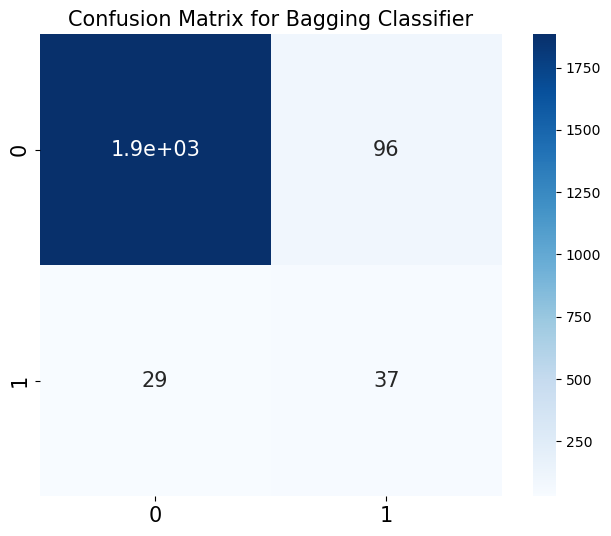

In [30]:
generate_results(bgclassifier, y_pred_bgg, 'Bagging Classifier')

In [31]:
print(metrics.roc_auc_score(y_test,y_pred_bgg))

0.7560606060606061


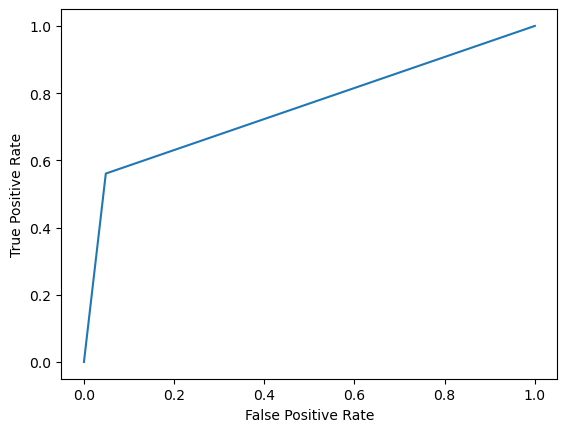

In [32]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,y_pred_bgg)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr)
display.plot()
plt.show()

#  ------------------------ Multinomial NB -----------------------

In [ ]:
# from sklearn.preprocessing import MinMaxScaler

# scaler = MinMaxScaler()

# # x_train_scale = scaler.fit_transform(x_train)

# y_train_scale = scaler.fit_transform(y_train)



In [ ]:
from sklearn.naive_bayes import MultinomialNB
MNBclf = MultinomialNB()
MNBclf.fit(x_train, y_train)

MultinomialNB()

In [ ]:
y_pred__MNB = MNBclf.predict(x_test)


In [ ]:
confusion_matrix = metrics.confusion_matrix(y_test, y_pred__MNB )
confusion_matrix

array([[1969,   11],
       [  62,    4]])


The classification report for MultinomialNB is:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1980
           1       0.27      0.06      0.10        66

    accuracy                           0.96      2046
   macro avg       0.62      0.53      0.54      2046
weighted avg       0.95      0.96      0.95      2046



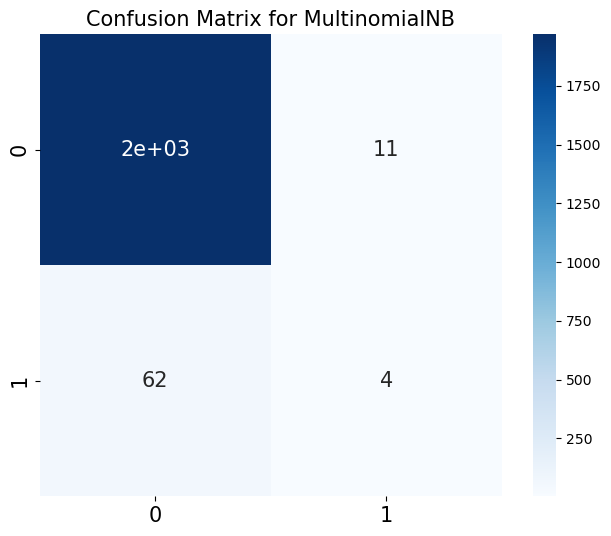

In [ ]:
generate_results(MNBclf, y_pred__MNB, 'MultinomialNB')

In [ ]:
print(metrics.roc_auc_score(y_test,y_pred__MNB))

0.5275252525252525


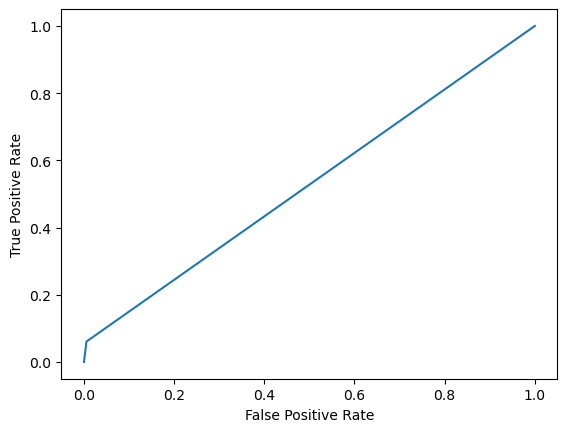

In [ ]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,y_pred__MNB)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr)
display.plot()
plt.show()

#  --------------- Quadratic Discriminant Analysis ------------------

In [ ]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

clf = QuadraticDiscriminantAnalysis().fit(x_train, y_train)
print(clf.predict(x_test))

[0 0 1 ... 0 1 0]


/Users/jaimesastrecrespo/opt/anaconda3/lib/python3.9/site-packages/sklearn/discriminant_analysis.py:878: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


In [ ]:
y_pred_clf=clf.predict(x_test)

In [ ]:
y_test

4214    0
4797    0
2458    0
4395    0
4955    0
       ..
6152    0
6768    0
4087    0
5129    0
6787    0
Name: Bankrupt?, Length: 2046, dtype: int64

In [ ]:
confusion_matrix = metrics.confusion_matrix(y_test, y_pred_clf)
confusion_matrix

array([[1620,  360],
       [  17,   49]])

In [ ]:
metrics.confusion_matrix(y_test, y_pred_clf)

array([[1620,  360],
       [  17,   49]])


The classification report for Quadratic Discriminant Analysis is:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      1980
           1       0.12      0.74      0.21        66

    accuracy                           0.82      2046
   macro avg       0.55      0.78      0.55      2046
weighted avg       0.96      0.82      0.87      2046



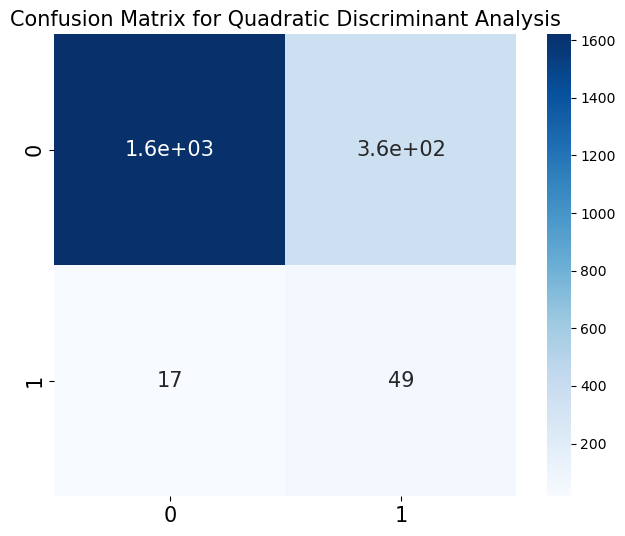

In [ ]:
generate_results(clf, y_pred_clf, 'Quadratic Discriminant Analysis')

In [ ]:
print(metrics.roc_auc_score(y_test,y_pred_clf))

0.7803030303030302


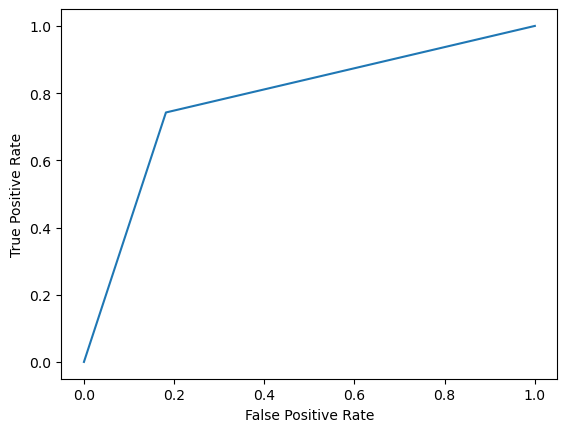

In [ ]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,y_pred_clf)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr)
display.plot()
plt.show()

#  ------------------------ Stacking -----------------------

In [ ]:
from sklearn.svm import NuSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import model_selection
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [ ]:
estimators = [('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
     ('knn', KNeighborsClassifier(n_neighbors=1)),
     ('SVC', NuSVC(nu=0.0345, class_weight='balanced'))]
stack_clf = StackingClassifier(
    estimators=estimators, final_estimator=LogisticRegression())

In [ ]:
stack_clf.fit(x_train, y_train).score(x_test, y_test)

0.9682306940371457

In [ ]:
y_pred_stack=stack_clf.predict(x_test)

In [ ]:
confusion_matrix = metrics.confusion_matrix(y_test, y_pred_stack)
confusion_matrix

array([[1969,   11],
       [  54,   12]])


The classification report for Stacking  is:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1980
           1       0.52      0.18      0.27        66

    accuracy                           0.97      2046
   macro avg       0.75      0.59      0.63      2046
weighted avg       0.96      0.97      0.96      2046



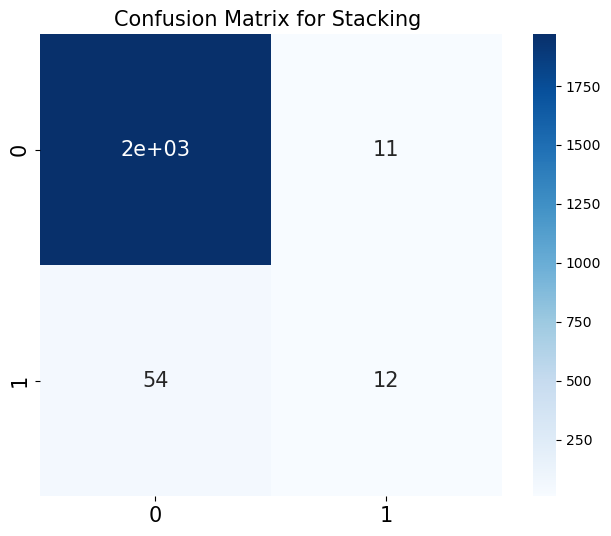

In [ ]:
generate_results(stack_clf, y_pred_stack, 'Stacking ')

In [ ]:
print(metrics.roc_auc_score(y_test,y_pred_stack))

0.5881313131313132


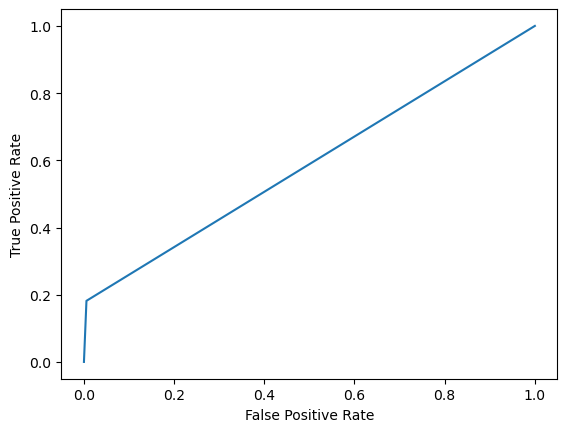

In [ ]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,y_pred_stack)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr)
display.plot()
plt.show()

#  ------------------------ RandomForest -----------------------

In [ ]:
rfc = RandomForestClassifier()
rfc.fit(x_train, y_train)
y_pred_rfc = rfc.predict(x_test)
acc_rfc = rfc.score(x_test, y_test)
print('The accuracy of the Random Forest Classifier is:', acc_rfc * 100, '%')

The accuracy of the Random Forest Classifier is: 96.96969696969697 %



The classification report for RandomForestClassifier is:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1980
           1       0.60      0.18      0.28        66

    accuracy                           0.97      2046
   macro avg       0.79      0.59      0.63      2046
weighted avg       0.96      0.97      0.96      2046



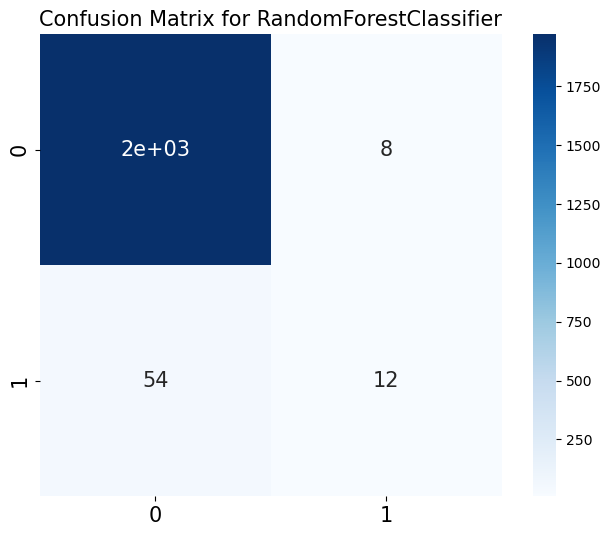

In [ ]:
generate_results(rfc, y_pred_rfc, 'RandomForestClassifier')

In [ ]:
print(metrics.roc_auc_score(y_test,y_pred_rfc))

0.5888888888888889


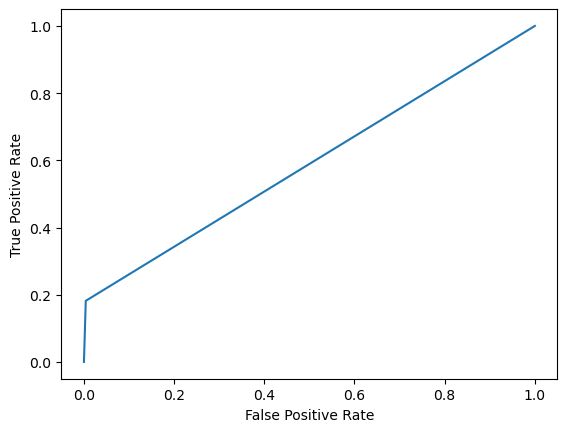

In [ ]:
fpr, tpr, thresholds = metrics.roc_curve(y_test,y_pred_rfc)
roc_auc = metrics.auc(fpr, tpr)
display = metrics.RocCurveDisplay(fpr=fpr, tpr=tpr)
display.plot()
plt.show()